In [1]:
!conda list cudnn
!nvcc --version

# packages in environment at C:\ProgramData\Anaconda3:
#
# Name                    Version                   Build  Channel
cudnn                     8.1.0.77             h3e0f4f4_0    conda-forge
nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Thu_Jun_11_22:26:48_Pacific_Daylight_Time_2020
Cuda compilation tools, release 11.0, V11.0.194
Build cuda_11.0_bu.relgpu_drvr445TC445_37.28540450_0


In [2]:
import sys, os
sys.path.insert(1, '../src')
import tensorflow as tf
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import plot_model
import numpy as np
from Modules import DLUNetModel, ImageVisualizer
from utils import (
    channel_dice, weighted_bce_and_dice_loss,
    mean_iou, dice_coef
)

In [3]:

# ===================================================================================
# MAIN PARAMETERS OF PROJECT (IDEALLY THIS SHOULD BE READ FROM A CONFIGURATION FILE)
# ===================================================================================

pwd = os.path.abspath('../')

########################
# DIR TO DATASETS
#########################

fold_data  = pwd + '/data/interim/BraTS2019/fold_data/'
train_data = pwd + '/data/processed/train/'
valid_data = pwd + '/data/processed/valid/'

Xtrain = train_data + 'Xtrain.npy'
Ytrain = train_data + 'Ytrain.npy'
Xval   = valid_data + 'Xval.npy'
Yval   = valid_data + "Yval.npy"

##################################################
# TAKE SAMPLE OF THE DATA IF YOU RAN OUT OF MEMORY
##################################################

SAMPLE = False
SAMPLE_RATIO = 0.5 #  0.5 means loading 50% of the data

#######################
# TRAINING PARAMETERS
#######################

BATCH_SIZE = 8
EPOCHS = 5

####################
# MODEL/RESULTS PATH
####################

model_path = pwd + '/models/'
if not os.path.exists(model_path):
    os.makedirs(model_path)
    
###################
# Avoid OOM errors
###################
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        print(gpu)
    except RuntimeError as e:
        print(e)

PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


In [4]:
import os
pwd = os.path.abspath('../')
!tree -L 4 {pwd}

/home/ahmedsalim/projects/BRATS-Image-Segmentation
├── data
│   ├── BraTS2019
│   │   ├── HGG
│   │   └── LGG
│   ├── interim
│   │   └── BraTS2019
│   │       ├── cropped_data
│   │       ├── fold_data
│   │       ├── n4_data
│   │       ├── pre_data
│   │       └── proc_data
│   └── processed
│       ├── train
│       └── valid
├── models
├── notebooks
│   ├── Brats_DL.ipynb
│   ├── Brats_Prep.ipynb
└── src
    ├── Modules.py
    ├── preprocessing.py
    ├── preprocessing_utils.py
    └── utils.py

17 directories, 7 files


# 1. Model Architecture

In [5]:
#################
# MODEL DEFENTION
#################

def setup_model():
    K.clear_session()
    
    Builder = DLUNetModel()
    model = Builder.build_model((192, 192, 4))

    model.compile(
        optimizer=Adam(),
        loss = weighted_bce_and_dice_loss,
        metrics = [
            mean_iou,
            dice_coef,
            channel_dice(c=2),
            channel_dice(c=3),
            channel_dice(c=4)
        ]
    )

    callbacks = [
        # EarlyStopping(patience=10, verbose=1),
        ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.00001, verbose=1),
        # ModelCheckpoint(model_path + 'Model.keras',
        #                 verbose=1,
        #                 save_best_only=True,
        #                 save_weights_only=True)
    ]
    
    return model, callbacks


model, callbacks = setup_model()
model.summary()


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 192, 192, 4  0           []                               
                                )]                                                                
                                                                                                  
 separable_conv2d (SeparableCon  (None, 192, 192, 64  356        ['input_1[0][0]']                
 v2D)                           )                                                                 
                                                                                                  
 separable_conv2d_1 (SeparableC  (None, 192, 192, 64  356        ['input_1[0][0]']                
 onv2D)                         )                                                             

In [6]:
plot_model(model, to_file= model_path + "Model.png", show_shapes=True, show_layer_names=True)

In [7]:
input_shape = model.input_shape
print("Model Input Shape:", input_shape)
output_shape = model.output_shape
print("Model Output Shape:", output_shape)

Model Input Shape: (None, 192, 192, 4)
Model Output Shape: (None, 192, 192, 5)


# 2. Model Training

In [8]:
if SAMPLE:
    Xtrain = np.load(Xtrain, mmap_mode='r')[:int(SAMPLE_RATIO * np.load(Xtrain, mmap_mode='r').shape[0])]
    Ytrain = np.load(Ytrain, mmap_mode='r')[:int(SAMPLE_RATIO * np.load(Ytrain, mmap_mode='r').shape[0])]
    Xval = np.load(Xval, mmap_mode='r')[:int(SAMPLE_RATIO * np.load(Xval, mmap_mode='r').shape[0])]
    Yval = np.load(Yval, mmap_mode='r')[:int(SAMPLE_RATIO * np.load(Yval, mmap_mode='r').shape[0])]
else:
    Xtrain = np.load(Xtrain, mmap_mode='r')
    Ytrain = np.load(Ytrain, mmap_mode='r')
    Xval = np.load(Xval, mmap_mode='r')
    Yval = np.load(Yval, mmap_mode='r')

print('Xtrain :' + str(Xtrain.shape))
print('Ytrain :' + str(Ytrain.shape))
print('Xval :' + str(Xval.shape))
print('Yval :' + str(Yval.shape))

Xtrain :(5512, 192, 192, 4)
Ytrain :(5512, 192, 192, 5)
Xval :(1311, 192, 192, 4)
Yval :(1311, 192, 192, 5)


In [9]:
#################
# MODEL TRAINING
#################
tf.keras.backend.clear_session()
history = model.fit(
    Xtrain,
    Ytrain,
    batch_size=BATCH_SIZE,
    epochs=EPOCHS,
    callbacks=callbacks,
    validation_data=(Xval, Yval)
)

Epoch 1/30
689/689 [==============================] - 10912s 692ms/step - loss: 0.0949 - mean_iou: 0.6982 - dice_coef: 0.9362 - dice_metric_channel_2: 0.4681 - dice_metric_channel_3: 0.3705 - dice_metric_channel_4: 0.7181 - val_loss: 0.0996 - val_mean_iou: 0.7637 - val_dice_coef: 0.9321 - val_dice_metric_channel_2: 0.5156 - val_dice_metric_channel_3: 0.3891 - val_dice_metric_channel_4: 0.7640 - lr: 0.0010
Epoch 2/30
689/689 [==============================] - 10678s 719ms/step - loss: 0.0499 - mean_iou: 0.7841 - dice_coef: 0.9780 - dice_metric_channel_2: 0.6965 - dice_metric_channel_3: 0.6255 - dice_metric_channel_4: 0.8430 - val_loss: 0.1769 - val_mean_iou: 0.7355 - val_dice_coef: 0.8413 - val_dice_metric_channel_2: 0.6404 - val_dice_metric_channel_3: 0.6193 - val_dice_metric_channel_4: 0.8096 - lr: 0.0010
Epoch 3/30
689/689 [==============================] - 10905s 685ms/step - loss: 0.0426 - mean_iou: 0.8112 - dice_coef: 0.9823 - dice_metric_channel_2: 0.7587 - dice_metric_channel_3:

Epoch 26/30
689/689 [==============================] - 10965s 710ms/step - loss: 0.0207 - mean_iou: 0.8969 - dice_coef: 0.9925 - dice_metric_channel_2: 0.9216 - dice_metric_channel_3: 0.8471 - dice_metric_channel_4: 0.9393 - val_loss: 0.0580 - val_mean_iou: 0.8174 - val_dice_coef: 0.9859 - val_dice_metric_channel_2: 0.7831 - val_dice_metric_channel_3: 0.7579 - val_dice_metric_channel_4: 0.8680 - lr: 1.0000e-05
Epoch 27/30
689/689 [==============================] - 10935s 700ms/step - loss: 0.0207 - mean_iou: 0.8970 - dice_coef: 0.9925 - dice_metric_channel_2: 0.9214 - dice_metric_channel_3: 0.8467 - dice_metric_channel_4: 0.9392 - val_loss: 0.0579 - val_mean_iou: 0.8176 - val_dice_coef: 0.9859 - val_dice_metric_channel_2: 0.7841 - val_dice_metric_channel_3: 0.7576 - val_dice_metric_channel_4: 0.8685 - lr: 1.0000e-05
Epoch 28/30
689/689 [==============================] - 10940s 730ms/step - loss: 0.0206 - mean_iou: 0.8971 - dice_coef: 0.9925 - dice_metric_channel_2: 0.9214 - dice_metric

In [10]:
model.save_weights(model_path + 'Model.keras')

In [11]:
################
# EVALUATE MODEL
################

model.evaluate(Xval, Yval, verbose=1,batch_size=BATCH_SIZE) # gives accuracy and loss as specified

# 3. Model Evaluation and Results

In [12]:
model, _ = setup_model()
model.load_weights(model_path + 'Model.keras')

1/1 [==============================] - 0s 1ms/step - loss: 0.1313 - mean_iou: 0.8353 - dice_coef: 0.9812 - dice_metric_channel_2: 0.8038 - dice_metric_channel_3: 0.8045 - dice_metric_channel_4: 0.7651


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 2ms/step - loss: 0.0525 - mean_iou: 0.8830 - dice_coef: 0.9856 - dice_metric_channel_2: 0.8744 - dice_metric_channel_3: 0.8278 - dice_metric_channel_4: 0.9204


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0248 - mean_iou: 0.8560 - dice_coef: 0.9922 - dice_metric_channel_2: 0.8983 - dice_metric_channel_3: 0.7300 - dice_metric_channel_4: 0.8873


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0233 - mean_iou: 0.8743 - dice_coef: 0.9936 - dice_metric_channel_2: 0.9162 - dice_metric_channel_3: 0.7627 - dice_metric_channel_4: 0.9405


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0094 - mean_iou: 0.9446 - dice_coef: 0.9973 - dice_metric_channel_2: 0.3322 - dice_metric_channel_3: 0.5995 - dice_metric_channel_4: 0.7647


/home/ahmedsalim/miniconda3/envs/tf-env/lib/python3.9/site-packages/ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


1/1 [==============================] - 0s 2ms/step - loss: 0.0599 - mean_iou: 0.8239 - dice_coef: 0.9898 - dice_metric_channel_2: 0.1322 - dice_metric_channel_3: 0.1065 - dice_metric_channel_4: 0.2940


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0070 - mean_iou: 0.9185 - dice_coef: 0.9975 - dice_metric_channel_2: 0.0422 - dice_metric_channel_3: 0.1478 - dice_metric_channel_4: 0.6273


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0892 - mean_iou: 0.8680 - dice_coef: 0.9822 - dice_metric_channel_2: 0.9023 - dice_metric_channel_3: 0.8134 - dice_metric_channel_4: 0.8978


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0382 - mean_iou: 0.8418 - dice_coef: 0.9884 - dice_metric_channel_2: 0.8600 - dice_metric_channel_3: 0.7512 - dice_metric_channel_4: 0.8607


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0277 - mean_iou: 0.9257 - dice_coef: 0.9893 - dice_metric_channel_2: 0.9652 - dice_metric_channel_3: 0.8084 - dice_metric_channel_4: 0.9673


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 2ms/step - loss: 0.0275 - mean_iou: 0.8976 - dice_coef: 0.9907 - dice_metric_channel_2: 0.9506 - dice_metric_channel_3: 0.8102 - dice_metric_channel_4: 0.9069


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0226 - mean_iou: 0.7905 - dice_coef: 0.9932 - dice_metric_channel_2: 0.6043 - dice_metric_channel_3: 0.7187 - dice_metric_channel_4: 0.8461


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0107 - mean_iou: 0.5361 - dice_coef: 0.9947 - dice_metric_channel_2: 0.0104 - dice_metric_channel_3: 0.0135 - dice_metric_channel_4: 0.6915


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 2ms/step - loss: 0.0110 - mean_iou: 0.9749 - dice_coef: 0.9951 - dice_metric_channel_2: 0.9742 - dice_metric_channel_3: 0.8945 - dice_metric_channel_4: 0.9760


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0648 - mean_iou: 0.8431 - dice_coef: 0.9835 - dice_metric_channel_2: 0.9463 - dice_metric_channel_3: 0.5307 - dice_metric_channel_4: 0.9596


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0445 - mean_iou: 0.7799 - dice_coef: 0.9901 - dice_metric_channel_2: 0.9477 - dice_metric_channel_3: 0.0263 - dice_metric_channel_4: 0.9659


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0038 - mean_iou: 0.8347 - dice_coef: 0.9990 - dice_metric_channel_2: 0.6406 - dice_metric_channel_3: 0.6138 - dice_metric_channel_4: 0.2638


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0472 - mean_iou: 0.7561 - dice_coef: 0.9865 - dice_metric_channel_2: 0.4370 - dice_metric_channel_3: 0.7096 - dice_metric_channel_4: 0.9328


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0331 - mean_iou: 0.8964 - dice_coef: 0.9898 - dice_metric_channel_2: 0.9423 - dice_metric_channel_3: 0.7609 - dice_metric_channel_4: 0.9571


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0152 - mean_iou: 0.9218 - dice_coef: 0.9949 - dice_metric_channel_2: 0.9501 - dice_metric_channel_3: 0.8665 - dice_metric_channel_4: 0.9387


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0315 - mean_iou: 0.6299 - dice_coef: 0.9827 - dice_metric_channel_2: 0.0062 - dice_metric_channel_3: 0.3400 - dice_metric_channel_4: 0.2696


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 2ms/step - loss: 0.0201 - mean_iou: 0.8660 - dice_coef: 0.9919 - dice_metric_channel_2: 0.8512 - dice_metric_channel_3: 0.7334 - dice_metric_channel_4: 0.9092


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0666 - mean_iou: 0.8659 - dice_coef: 0.9846 - dice_metric_channel_2: 0.9323 - dice_metric_channel_3: 0.7276 - dice_metric_channel_4: 0.9279


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0674 - mean_iou: 0.6968 - dice_coef: 0.9830 - dice_metric_channel_2: 0.6736 - dice_metric_channel_3: 0.6032 - dice_metric_channel_4: 0.6015


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0347 - mean_iou: 0.8992 - dice_coef: 0.9923 - dice_metric_channel_2: 0.8641 - dice_metric_channel_3: 0.8883 - dice_metric_channel_4: 0.9165


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0365 - mean_iou: 0.8975 - dice_coef: 0.9874 - dice_metric_channel_2: 0.8990 - dice_metric_channel_3: 0.8449 - dice_metric_channel_4: 0.9200


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 2ms/step - loss: 0.5236 - mean_iou: 0.4700 - dice_coef: 0.9104 - dice_metric_channel_2: 0.1898 - dice_metric_channel_3: 0.3444 - dice_metric_channel_4: 0.3740


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.1117 - mean_iou: 0.8318 - dice_coef: 0.9747 - dice_metric_channel_2: 0.9059 - dice_metric_channel_3: 0.9041 - dice_metric_channel_4: 0.6028


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0048 - mean_iou: 0.9696 - dice_coef: 0.9971 - dice_metric_channel_2: 0.0642 - dice_metric_channel_3: 0.0845 - dice_metric_channel_4: 0.8077


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.1114 - mean_iou: 0.7245 - dice_coef: 0.9713 - dice_metric_channel_2: 0.6555 - dice_metric_channel_3: 0.6177 - dice_metric_channel_4: 0.8686


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0778 - mean_iou: 0.8703 - dice_coef: 0.9832 - dice_metric_channel_2: 0.9207 - dice_metric_channel_3: 0.7834 - dice_metric_channel_4: 0.9128


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0125 - mean_iou: 0.5244 - dice_coef: 0.9956 - dice_metric_channel_2: 0.1542 - dice_metric_channel_3: 0.1895 - dice_metric_channel_4: 0.3097


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 2ms/step - loss: 0.1293 - mean_iou: 0.8609 - dice_coef: 0.9700 - dice_metric_channel_2: 0.8308 - dice_metric_channel_3: 0.7947 - dice_metric_channel_4: 0.9570


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0156 - mean_iou: 0.6747 - dice_coef: 0.9961 - dice_metric_channel_2: 0.0870 - dice_metric_channel_3: 0.0839 - dice_metric_channel_4: 0.1344


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.1101 - mean_iou: 0.8745 - dice_coef: 0.9680 - dice_metric_channel_2: 0.8887 - dice_metric_channel_3: 0.8171 - dice_metric_channel_4: 0.9070


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0581 - mean_iou: 0.8632 - dice_coef: 0.9861 - dice_metric_channel_2: 0.9247 - dice_metric_channel_3: 0.6948 - dice_metric_channel_4: 0.9527


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 2ms/step - loss: 0.2594 - mean_iou: 0.7701 - dice_coef: 0.9540 - dice_metric_channel_2: 0.8712 - dice_metric_channel_3: 0.6730 - dice_metric_channel_4: 0.8000


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0351 - mean_iou: 0.9096 - dice_coef: 0.9900 - dice_metric_channel_2: 0.9569 - dice_metric_channel_3: 0.7910 - dice_metric_channel_4: 0.9664


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0806 - mean_iou: 0.4328 - dice_coef: 0.9860 - dice_metric_channel_2: 0.0230 - dice_metric_channel_3: 0.0246 - dice_metric_channel_4: 0.2074


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0650 - mean_iou: 0.9416 - dice_coef: 0.9834 - dice_metric_channel_2: 0.9615 - dice_metric_channel_3: 0.9339 - dice_metric_channel_4: 0.9339


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 2ms/step - loss: 0.0226 - mean_iou: 0.8432 - dice_coef: 0.9923 - dice_metric_channel_2: 0.8141 - dice_metric_channel_3: 0.8028 - dice_metric_channel_4: 0.8144


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0646 - mean_iou: 0.8951 - dice_coef: 0.9855 - dice_metric_channel_2: 0.9319 - dice_metric_channel_3: 0.8444 - dice_metric_channel_4: 0.9164


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.1348 - mean_iou: 0.8251 - dice_coef: 0.9614 - dice_metric_channel_2: 0.8504 - dice_metric_channel_3: 0.6569 - dice_metric_channel_4: 0.9403


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0309 - mean_iou: 0.8568 - dice_coef: 0.9925 - dice_metric_channel_2: 0.8906 - dice_metric_channel_3: 0.7722 - dice_metric_channel_4: 0.8520


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0426 - mean_iou: 0.8422 - dice_coef: 0.9882 - dice_metric_channel_2: 0.8519 - dice_metric_channel_3: 0.7411 - dice_metric_channel_4: 0.8913


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0407 - mean_iou: 0.7836 - dice_coef: 0.9903 - dice_metric_channel_2: 0.9529 - dice_metric_channel_3: 0.0314 - dice_metric_channel_4: 0.9646


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 2ms/step - loss: 0.0188 - mean_iou: 0.9533 - dice_coef: 0.9927 - dice_metric_channel_2: 0.9344 - dice_metric_channel_3: 0.8955 - dice_metric_channel_4: 0.9689


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0160 - mean_iou: 0.6763 - dice_coef: 0.9958 - dice_metric_channel_2: 0.3925 - dice_metric_channel_3: 0.4102 - dice_metric_channel_4: 0.4970


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0189 - mean_iou: 0.8578 - dice_coef: 0.9946 - dice_metric_channel_2: 0.8047 - dice_metric_channel_3: 0.8158 - dice_metric_channel_4: 0.9148


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0141 - mean_iou: 0.6054 - dice_coef: 0.9967 - dice_metric_channel_2: 0.0494 - dice_metric_channel_3: 0.0447 - dice_metric_channel_4: 0.9637


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0509 - mean_iou: 0.8643 - dice_coef: 0.9852 - dice_metric_channel_2: 0.9266 - dice_metric_channel_3: 0.7246 - dice_metric_channel_4: 0.9356


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 2ms/step - loss: 0.0467 - mean_iou: 0.8447 - dice_coef: 0.9851 - dice_metric_channel_2: 0.8332 - dice_metric_channel_3: 0.6639 - dice_metric_channel_4: 0.9569


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 2ms/step - loss: 0.0145 - mean_iou: 0.6822 - dice_coef: 0.9951 - dice_metric_channel_2: 0.1468 - dice_metric_channel_3: 0.1845 - dice_metric_channel_4: 0.9251


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0438 - mean_iou: 0.8812 - dice_coef: 0.9869 - dice_metric_channel_2: 0.9288 - dice_metric_channel_3: 0.7606 - dice_metric_channel_4: 0.9527


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0163 - mean_iou: 0.9488 - dice_coef: 0.9941 - dice_metric_channel_2: 0.9708 - dice_metric_channel_3: 0.8742 - dice_metric_channel_4: 0.9600


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0836 - mean_iou: 0.8673 - dice_coef: 0.9774 - dice_metric_channel_2: 0.8820 - dice_metric_channel_3: 0.7018 - dice_metric_channel_4: 0.9499


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 2ms/step - loss: 0.0312 - mean_iou: 0.9048 - dice_coef: 0.9901 - dice_metric_channel_2: 0.9123 - dice_metric_channel_3: 0.8988 - dice_metric_channel_4: 0.8949


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 1ms/step - loss: 0.0306 - mean_iou: 0.9531 - dice_coef: 0.9940 - dice_metric_channel_2: 0.2045 - dice_metric_channel_3: 0.9446 - dice_metric_channel_4: 0.8793


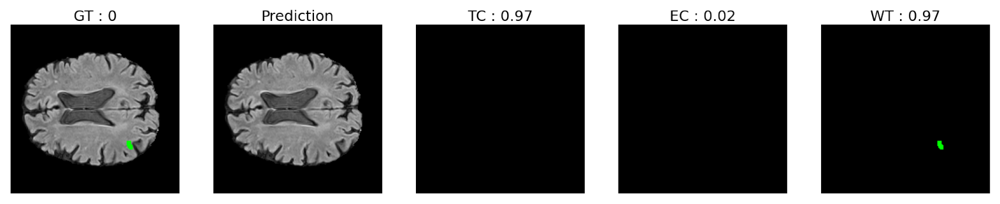

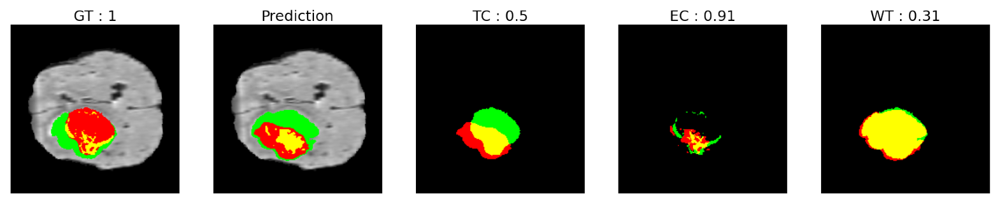

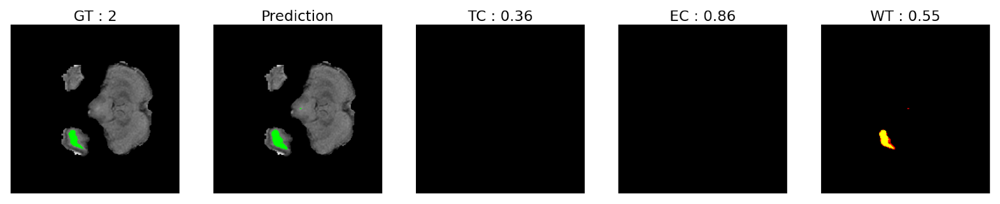

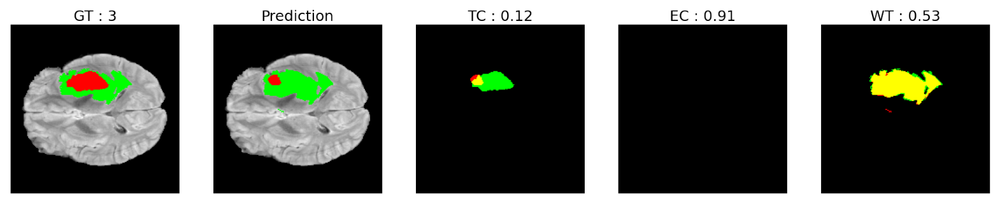

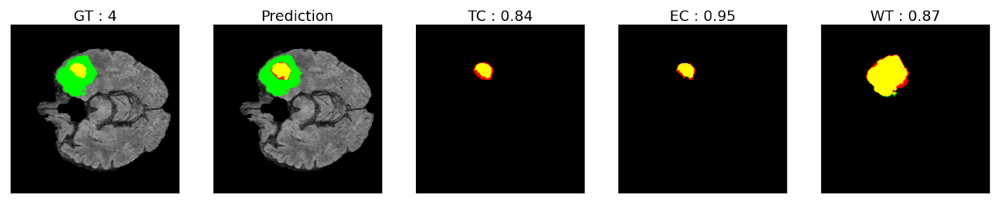

...

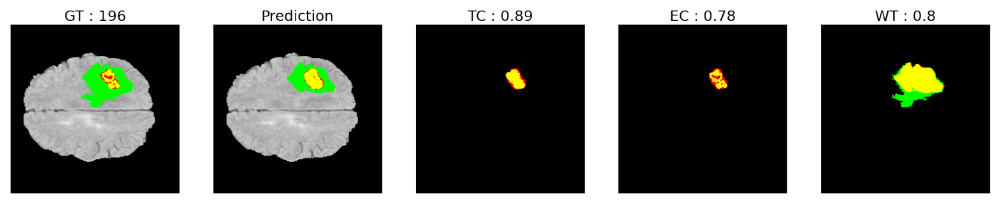

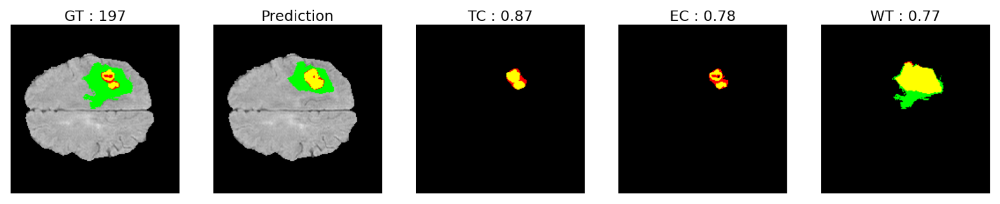

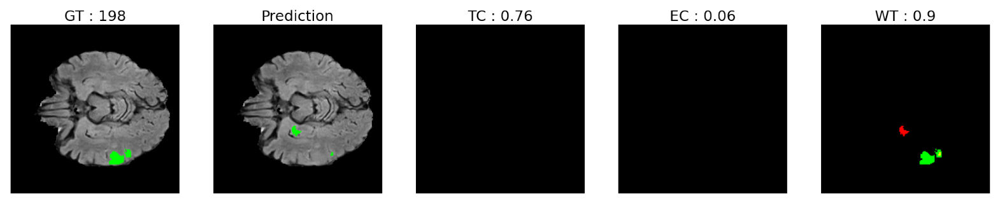

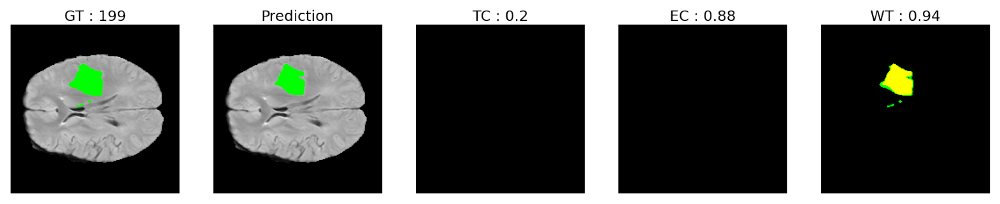

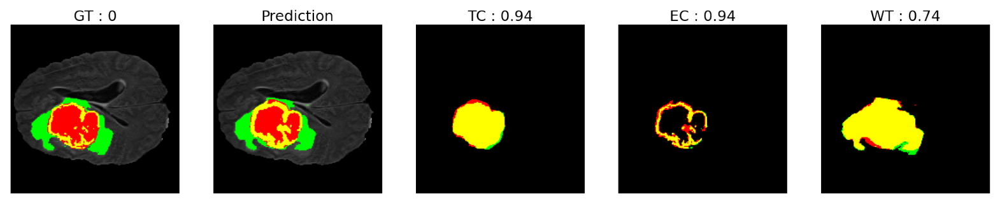

In [13]:
###################
# VIEW PREDECTIONS
###################

visualizer = ImageVisualizer()
visualizer.visualize_results(Xval[:200], Yval[:200], model)

1/1 [==============================] - 0s 59ms/step - loss: 0.0659  - mean_iou: 0.8872 - dice_coef: 0.9810 - dice_metric_channel_2: 0.9416 - dice_metric_channel_3: 0.7374 - dice_metric_channel_4: 0.9433


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


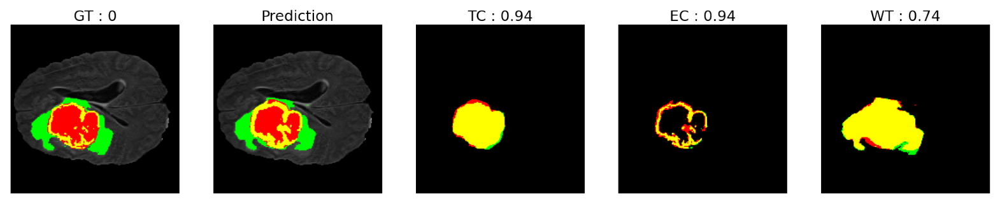

In [14]:
##########################################
# VIEW PREDECTIONS FROM fold_data folder
##########################################
FoldX1 = np.load(fold_data + "X_0.npy")
FoldY1 = np.load(fold_data + "Y_0.npy")

visualizer = ImageVisualizer()
visualizer.visualize_results(FoldX1[346:347], FoldY1[346:347], model) # make sure to use same indexes, as FoldX1 is the image, and FoldY1 is the segmentation label